In [48]:
import pandas as pd
import numpy as np
import seaborn as sns

In [2]:
# Reading DataSet
dataset=pd.read_csv("train.csv")

In [3]:
#Droping unnecessary columns
dataset=dataset.drop(columns=['Dev_ID','Geographic_Regions','Gender','Age','Project_Age','Dev_Status','Education','Expt_Het'],axis=1)

In [4]:
dataset.head()

,Int_Learn,Fin_Gain,Tech_Cont_Norm,Sys_Int,Cod_Test_Task,Cont_Code_Dec,Dec_Right_Dec,Dev_Inv,Proj_Desertion,Promoted,Dev_Experience
0,6.00,5.00,4.67,5.50,4.8,3.8,4.2,4.0,7.0,0,1
1,5.67,4.75,4.50,4.75,4.6,4.0,3.6,6.2,2.4,1,5
2,6.67,6.50,4.83,6.00,6.2,5.4,3.6,6.8,4.0,0,1
3,5.67,5.75,5.33,6.50,3.8,1.8,2.2,7.0,1.4,1,1
4,5.00,5.50,4.67,5.00,4.2,3.2,4.2,4.4,3.8,0,2


In [5]:
# Printing all the column names for our reference
dataset.columns

Index(['Int_Learn', 'Fin_Gain', 'Tech_Cont_Norm', 'Sys_Int', 'Cod_Test_Task',
       'Cont_Code_Dec', 'Dec_Right_Dec', 'Dev_Inv', 'Proj_Desertion',
       'Promoted', 'Dev_Experience'],
      dtype='object')

In [6]:
# Separate Target Variable and Predictor Variables
TargetVariable='Promoted'
Predictors=[i for i in dataset.columns if i not in TargetVariable]
print(Predictors)
X=dataset[Predictors].values
y=dataset[TargetVariable].values

# Split the data into training and testing set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=428)

['Int_Learn', 'Fin_Gain', 'Tech_Cont_Norm', 'Sys_Int', 'Cod_Test_Task', 'Cont_Code_Dec', 'Dec_Right_Dec', 'Dev_Inv', 'Proj_Desertion', 'Dev_Experience']


In [7]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(121, 10) (52, 10) (121,) (52,)


In [8]:
### Sandardization of data ###
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Choose either standardization or Normalization
# On this data Min Max Normalization produced better results

# Choose between standardization and MinMAx normalization
#PredictorScaler=StandardScaler()
PredictorScaler=MinMaxScaler()

# Storing the fit object for later reference
PredictorScalerFit=PredictorScaler.fit(X)

# Generating the standardized values of X
X=PredictorScalerFit.transform(X)

# Split the data into training and testing set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [9]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(121, 10) (52, 10) (121,) (52,)


In [55]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
# choose parameter Penalty='l1' or C=1
# choose different values for solver 'newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'
clf = LogisticRegression(C=1,penalty='l2', solver='newton-cg')

# Printing all the parameters of logistic regression
# print(clf)

# Creating the model on Training Data
LOG=clf.fit(X_train,y_train)
prediction_log=LOG.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_log))
print(metrics.confusion_matrix(y_test, prediction_log))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_log, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(LOG, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

              precision    recall  f1-score   support

           0       0.92      0.98      0.95        45
           1       0.75      0.43      0.55         7

    accuracy                           0.90        52
   macro avg       0.83      0.70      0.75        52
weighted avg       0.89      0.90      0.89        52

[[44  1]
 [ 4  3]]
Accuracy of the model on Testing Sample Data: 0.89

Accuracy values for 10-fold Cross Validation:
 [0.75757576 0.86458333 0.86458333 0.82720588 0.93232132 0.82720588
 0.80892495 0.85686275 0.71372549 1.        ]

Final Average Accuracy of the model: 0.85


DecisionTreeClassifier()
              precision    recall  f1-score   support

           0       1.00      0.93      0.97        45
           1       0.70      1.00      0.82         7

    accuracy                           0.94        52
   macro avg       0.85      0.97      0.89        52
weighted avg       0.96      0.94      0.95        52

[[42  3]
 [ 0  7]]
Accuracy of the model on Testing Sample Data: 0.95

Accuracy values for 10-fold Cross Validation:
 [0.86458333 0.93978495 0.94745484 0.88235294 0.88235294 0.93232132
 0.94428883 1.         0.80892495 1.        ]

Final Average Accuracy of the model: 0.92


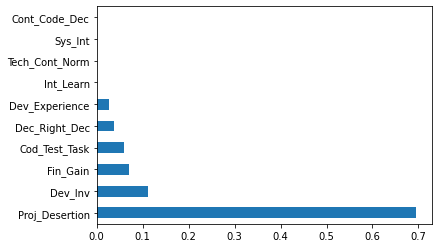

In [21]:
#Decision Trees
from sklearn import tree
#choose from different tunable hyper parameters
clf = tree.DecisionTreeClassifier()

# Printing all the parameters of Decision Trees
print(clf)

# Creating the model on Training Data
DTree=clf.fit(X_train,y_train)
prediction_DT=DTree.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_DT))
print(metrics.confusion_matrix(y_test, prediction_DT))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_DT, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Plotting the feature importance for Top 10 most important columns
%matplotlib inline
feature_importances = pd.Series(DTree.feature_importances_, index=Predictors)
feature_importances.nlargest(10).plot(kind='barh')

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(DTree, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

[Text(0.5416666666666666, 0.9166666666666666, 'X[8] <= 0.317\ngini = 0.276\nsamples = 121\nvalue = [101, 20]'),
 Text(0.25, 0.75, 'X[1] <= 0.375\ngini = 0.308\nsamples = 21\nvalue = [4, 17]'),
 Text(0.16666666666666666, 0.5833333333333334, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(0.3333333333333333, 0.5833333333333334, 'X[6] <= 0.932\ngini = 0.255\nsamples = 20\nvalue = [3, 17]'),
 Text(0.16666666666666666, 0.4166666666666667, 'X[9] <= 0.9\ngini = 0.117\nsamples = 16\nvalue = [1, 15]'),
 Text(0.08333333333333333, 0.25, 'gini = 0.0\nsamples = 14\nvalue = [0, 14]'),
 Text(0.25, 0.25, 'X[1] <= 0.854\ngini = 0.5\nsamples = 2\nvalue = [1, 1]'),
 Text(0.16666666666666666, 0.08333333333333333, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(0.3333333333333333, 0.08333333333333333, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(0.5, 0.4166666666666667, 'X[4] <= 0.981\ngini = 0.5\nsamples = 4\nvalue = [2, 2]'),
 Text(0.4166666666666667, 0.25, 'gini = 0.0\nsamples = 2\nvalue = [2, 

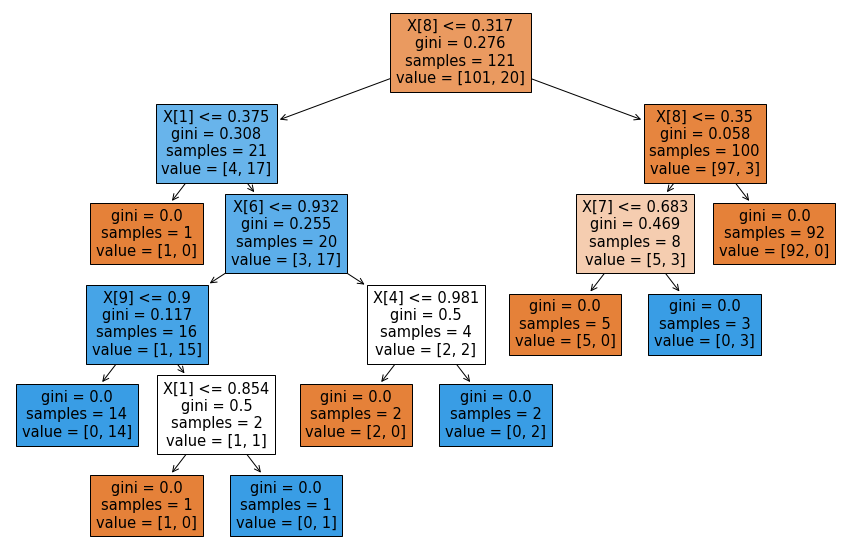

In [22]:
from sklearn import tree
import matplotlib.pyplot as plt
plt.figure(figsize=(15,10))
tree.plot_tree(clf,filled=True)

In [63]:
from sklearn.metrics import roc_curve, auc
roc_curve(y_test, prediction_DT)

(array([0.        , 0.06666667, 1.        ]),
 array([0., 1., 1.]),
 array([2, 1, 0]))

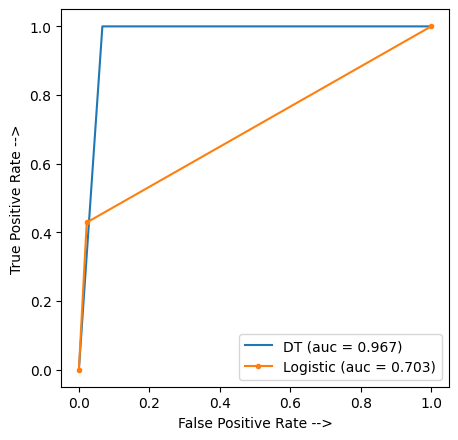

In [65]:
from sklearn.metrics import roc_curve, auc

DT_fpr, DT_tpr, threshold = roc_curve(y_test, prediction_DT)
auc_DT = auc(DT_fpr,DT_tpr)

logistic_fpr, logistic_tpr, threshold = roc_curve(y_test, prediction_log)
auc_logistic = auc(logistic_fpr, logistic_tpr)

plt.figure(figsize=(5, 5), dpi=100)
plt.plot(DT_fpr, DT_tpr, linestyle='-', label='DT (auc = %0.3f)' % auc_DT)
plt.plot(logistic_fpr, logistic_tpr, marker='.', label='Logistic (auc = %0.3f)' % auc_logistic)

plt.xlabel('False Positive Rate -->')
plt.ylabel('True Positive Rate -->')

plt.legend()

plt.show()

In [26]:
#Hyperparameter tuning for decision tree
params={
 "splitter"    : ["best","random"] ,
    "criterion":['gini','entropy'],
 "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
 "min_samples_leaf" : [ 1,2,3,4,5 ],
"min_weight_fraction_leaf":[0.1,0.2,0.3,0.4],
 "max_features" : ["auto","log2","sqrt",None ],
    "max_leaf_nodes":[None,10,20,30,40,50,60,70]
    
}

In [14]:

## Hyperparameter optimization using GridSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
dtree=DecisionTreeClassifier()

random_search=GridSearchCV(dtree,param_grid=params,scoring='f1_weighted',n_jobs=-1,cv=5,verbose=3)
random_search.fit(X,y)

Fitting 5 folds for each of 20480 candidates, totalling 102400 fits


/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.739 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.871 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_wei

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1,

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_w

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_wei

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_w

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.755 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_wei

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_w

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_frac

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fr

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_lea

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.922 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_wei

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_frac

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_w

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_w

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_wei

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_wei

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_wei

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_w

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=2,

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, m

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_wei

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_

[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_wei

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_

[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weigh

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_

[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_wei

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_

[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.922 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_wei

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.749 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.824 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=rand

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1,

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, m

[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_wei

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_w

[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.910 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_wei

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_wei

[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weigh

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_wei

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weigh

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_w

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_w

[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weigh

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, m

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, m

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.873 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.921 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_frac

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_wei

[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weigh

[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_w

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.893 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weigh

[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weigh

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=1,

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, m

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=5,

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_frac

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.871 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_w

[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_w

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_wei

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weigh

[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weigh

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_w

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_w

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weigh

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

les_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criteri

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.844 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, m

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4,

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_w

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weigh

[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_w

[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weigh

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weigh

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_w

[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weigh

[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, m

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5,

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_frac

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_w

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_w

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weigh

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weigh

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_wei

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_w

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=

[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4,

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_w

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_

[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weigh

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_wei

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_wei

[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weigh

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_wei

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.886 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_wei

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.852 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.1s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.739 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.861 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.846 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weigh

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weigh

[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_

[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weigh

[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_wei

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_wei

[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_

[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_wei

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weigh

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_wei

[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weigh

[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1,

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_l

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_

[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_w

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_frac

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_wei

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weigh

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_frac

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_

[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weigh

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, m

[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_frac

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_w

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.804 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_wei

[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fr

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.902 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_wei

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_frac

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.1s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_frac

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fr

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

h=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_w

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_frac

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, m

[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_lea

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.815 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weigh

[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_w

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weigh

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_

[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weigh

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.829 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weigh

[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_

[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weigh

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_wei

[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_frac

[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_w

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, m

[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_lea

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_w

[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fr

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_w

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fr

[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weigh

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.943 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_wei

[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fr

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_w

[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_wei

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5,

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fr

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fr

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.921 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_wei

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weigh

[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_w

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weigh

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weigh

[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weigh

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fr

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_w

ved in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.861 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weigh

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples

[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=None, min_sampl

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.814 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min

[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_wei

[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_wei

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weigh

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_w

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weigh

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, m

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4,

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weigh

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_sampl

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples

[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, m

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, m

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_wei

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, m

[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weigh

[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, m

[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_w

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_l

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_wei

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_w

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.820 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, m

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_wei

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_w

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_w

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=4,

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_w

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.807 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_wei

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, m

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_wei

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.771 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.861 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.780 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=None, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_wei

[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_l

[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_l

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2,

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_w

[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weigh

[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, m

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_wei

[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, m

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_wei

[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, m

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_w

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weigh

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.902 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weigh

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples

[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_sampl

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min

[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, m

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_w

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4,

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.829 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.902 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_w

[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_wei

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weigh

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.922 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4,

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_w

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3,

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_wei

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_w

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_lea

[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=None, min_sampl

[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1,

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.945 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, m

[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, m

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_w

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=4,

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_w

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_w

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.846 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min

[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_w

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=2,

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, m

[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.902 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.943 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.945 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_w

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_wei

[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_sampl

[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_l

[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weigh

[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weigh

[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.861 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min

[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_wei

[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.871 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, m

[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_w

[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weigh

[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min

[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, m

[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_wei

[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_w

[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min

[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_w

[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1,

[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_w

[CV 5/5] END criterion=gini, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_lea

[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_lea

[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1,

[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min

[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_wei

[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weigh

[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min

[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min

[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min

[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3,

[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_w

[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_wei

[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weigh

[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2,

[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, m

[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_wei

[CV 5/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min

[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples

[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_l

[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weigh

[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_wei

[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.1s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min

[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weigh

[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weigh

[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weigh

[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_wei

[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, m

[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_wei

[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min

[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weigh

[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.871 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, m

[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_w

[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_wei

[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_wei

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.723 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=10, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.862 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=30, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=50, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.844 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=60, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=70, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, m

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.947 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=Non

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None,

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_sampl

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples

[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.1s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=40, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=50, min_sampl

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=60, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_sampl

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=70, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=Non

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=None, min

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_sampl

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=50, min_samples

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.902 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, max_leaf_nodes=70, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, m

[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, min

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_sam

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=50, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_sam

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=60, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.835 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.1s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=None, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

ND criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.739 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=20, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=30, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.1s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=40, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples

d in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=60, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, max_leaf_nodes=70, min_sam

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=Non

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_s

[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_s

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples

[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=10, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_sam

[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=20, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_sam

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.829 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=30, min_sam

[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_sampl

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=40, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=50, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=60, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, max_leaf_nodes=70, min_sampl

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=N

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, m

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_s

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_sampl

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=10, min_samples

[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_sampl

[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=20, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=30, min_samples

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.1s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=40, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_sampl

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=50, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_sam

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=60, min_sampl

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, max_leaf_nodes=70, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, m

[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=Non

[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_sampl

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=10, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=20, min_sampl

[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=30, min_sampl

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples

[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=40, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples

[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=50, min_sampl

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=60, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, m

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=Non

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.910 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.921 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.739 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=30, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.730 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.745 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.748 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=50, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=60, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.858 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.807 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.1s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.842 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_sam

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=70, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, min_s

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_sampl

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=20, min_sampl

[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_sampl

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=30, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=40, min_sam

[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.1s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_sam

[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=50, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.770 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=60, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_sam

[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=70, min_sam

[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.802 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=N

[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None,

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=10, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=40, min_samples

[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_sampl

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=60, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=Non

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=None, m

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=10, min_samples

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=20, min_sampl

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_sampl

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_sampl

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_sampl

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, max_leaf_nodes=70, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.771 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None,

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=10, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=20, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=30, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=40, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=50, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=60, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, max_leaf_nodes=70, min_sampl

[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, m

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None,

[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=None, min

[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=20, min_samples

[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.921 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=30, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=40, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=50, min_samples

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=60, min_sam

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, max_leaf_nodes=70, min_samples

[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=Non

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, m

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples

[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=10, min_sampl

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=20, min_sampl

[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.723 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples

[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=40, min_samples

[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=

[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.752 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, max_leaf_nodes=70, min_samples

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=Non

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=None,

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_sam

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=10, min_sampl

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.945 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=20, min_sam

[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=40, min_sampl

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=50, min_samples_leaf=

[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=60, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_sam

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, max_leaf_nodes=70, min_samples_lea

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=None, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=10, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.862 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=30, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=40, min_samples_l

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.910 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.798 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=60, min_samples_leaf=

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.802 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, max_leaf_nodes=70, min_sampl

[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None,

[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=None, m

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.820 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=10, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_sam

[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=20, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_sampl

[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=30, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_sampl

[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.739 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.793 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=40, min_samples

[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=50, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_sampl

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=60, min_sam

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_sam

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.814 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.755 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, max_leaf_nodes=70, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=Non

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, m

[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=None, m

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=10, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=20, min_sam

[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_sam

[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_sampl

[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_sampl

[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=50, min_sampl

[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.829 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None,

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=None, min

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_sampl

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=10, min_samples

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_sampl

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=20, min_sam

[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=30, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_sampl

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=40, min_sampl

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.820 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=50, min_sampl

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=60, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, max_leaf_nodes=70, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_n

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=Non

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=1

d in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, mi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=10, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_sa

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=20, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, 

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=30, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=40, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, mi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=60, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, max_leaf_nodes=70, min_samples

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nod

[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=None,

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_sa


[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=10, min_

[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samp


[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_sa

[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=20, min_s

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_sampl

[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.842 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=40, min_samples

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_s


[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.873 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, mi

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=50, m

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_sam

[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=60, min_samples

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_s

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, max_leaf_nodes=70, min_sam

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes

[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes

[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=10, min_s


[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, mi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.820 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=20, m

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_s

[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min

[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=40, min

[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.837 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples

[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_s


[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, mi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=60, min_sampl

[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.873 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_sa

[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, max_leaf_nodes=70, min_s

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_n

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_s

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_sampl


[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=20, mi

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_sampl

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_sampl

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, m

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=40, min_sam

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.770 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_s

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=50, min

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_sa

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=60, min_sam

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, m

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=Non

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.898 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=Non

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=10, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=20, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.745 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=30, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples

d in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:

[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=40, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=50, min_sample

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.829 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_sa

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, max_leaf_nodes=70, min_s

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None,

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nod

[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=N

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=10, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_sam


[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.804 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=20, min_samples


[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=30, min

[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=40, m


[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_sa

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=50, m

[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=60, min_sampl

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, m

[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, max_leaf_nodes=70, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nod

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=N

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.941 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=10, m

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=20, min_sam

[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.946 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples

[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_s

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=30, min_sampl

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_sam

[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_sam

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_sampl

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.902 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=1.000 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=50, min_samples

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.737 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_sampl

[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=60, min_sam

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.970 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.1s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.858 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nod

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.892 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_s

[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_sam

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min

[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=20, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=30, min_sampl

[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=40, m

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samp

[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=50, m

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min

[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=60, min_samples

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_

[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.871 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_s

[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, max_leaf_nodes=70, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_n

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_n

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.943 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.920 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=10, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.861 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=20, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=1.000 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=30, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=40, m

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_sam

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_s

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi


[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, mi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=60, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_sampl

/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/home/abdullyahuza/shehuDir/env/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behavi

[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=auto, max_leaf_nodes=70, min_sam

[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nod

[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=None,

[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_sam

[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_sampl

[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=10, min_sam

[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min

[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_s

[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_sam

[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=30, min_

[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_sampl

[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=40, min_sa

[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.921 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_sampl

[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min

[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=50, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min

[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=60, m

[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.895 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_s

[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s[CV 2/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, mi

[CV 4/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=log2, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.868 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None,

[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nod

[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.886 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=0.755 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples

[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_sample


[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=10, 

[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.861 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_s

[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.807 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=20, min_sample

[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_sam

[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=30, min_sam

[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.873 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.820 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, m

[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_s


[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_sample

[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.937 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min

[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=50, min_s

[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, m

[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=60, min_sam

[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.870 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.908 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_sampl

[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=0.852 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=sqrt, max_leaf_nodes=70, min_sam

[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nod

[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.943 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.824 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=0.969 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nod

[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_s

[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=10, m

[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_sam

[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=20, min_sampl

[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.851 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_s

[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=30, min

[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.920 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_s

[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.945 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=0.751 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_s

[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, m

[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=50, min_sampl

[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.791 total time=   0.0s[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=0.941 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=1.000 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=0.911 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_sa


[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samp

[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=0.785 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=0.798 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=60, min_sampl

[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.837 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.890 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.972 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=0.896 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_s

[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.917 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.915 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=0.972 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=15, max_features=None, max_leaf_nodes=70, m

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [3, 4, 5, 6, 8, 10, 12, 15],
                         'max_features': ['auto', 'log2', 'sqrt', None],
                         'max_leaf_nodes': [None, 10, 20, 30, 40, 50, 60, 70],
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_weight_fraction_leaf': [0.1, 0.2, 0.3, 0.4],
                         'splitter': ['best', 'random']},
             scoring='f1_weighted', verbose=3)

In [15]:
random_search.best_params_

{'criterion': 'entropy',
 'max_depth': 5,
 'max_features': 'log2',
 'max_leaf_nodes': 20,
 'min_samples_leaf': 5,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'best'}

In [16]:
random_search.best_score_

0.9508680662565858

RandomForestClassifier(criterion='entropy', max_depth=10)
              precision    recall  f1-score   support

           0       0.93      0.96      0.95        45
           1       0.67      0.57      0.62         7

    accuracy                           0.90        52
   macro avg       0.80      0.76      0.78        52
weighted avg       0.90      0.90      0.90        52

[[43  2]
 [ 3  4]]
Accuracy of the model on Testing Sample Data: 0.9

Accuracy values for 10-fold Cross Validation:
 [0.93978495 0.93978495 0.94745484 0.88235294 0.88235294 0.79696395
 0.88235294 0.93630832 0.94428883 1.        ]

Final Average Accuracy of the model: 0.92


<AxesSubplot:>

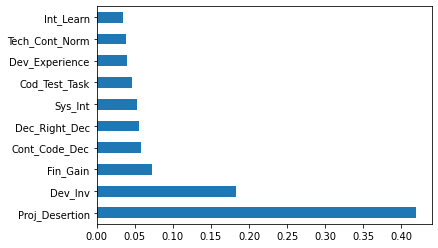

In [18]:
# Random Forest (Bagging of multiple Decision Trees)
from sklearn.ensemble import RandomForestClassifier
# Choose various values of max_depth, n_estimators and criterion for tuning the model
random = RandomForestClassifier(max_depth=10, n_estimators=100,criterion='entropy')


# Printing all the parameters of Random Forest
print(random)

# Creating the model on Training Data
RF=random.fit(X_train,y_train)
prediction_RF=RF.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_RF))
print(metrics.confusion_matrix(y_test, prediction_RF))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_RF, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(RF, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))


# Plotting the feature importance for Top 4 most important columns
%matplotlib inline
feature_importances = pd.Series(RF.feature_importances_, index=Predictors)
feature_importances.nlargest(10).plot(kind='barh')

In [19]:
from sklearn.metrics import roc_curve, auc
roc_curve(y_test, prediction_RF)

(array([0.        , 0.04444444, 1.        ]),
 array([0.        , 0.57142857, 1.        ]),
 array([2, 1, 0]))

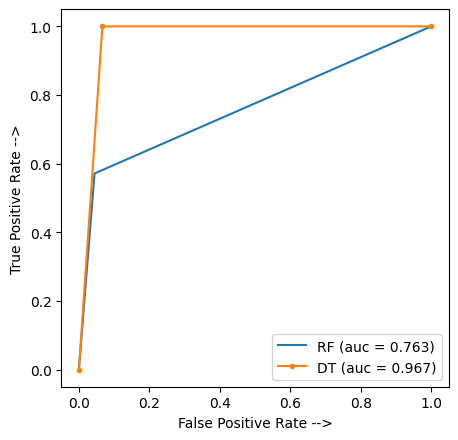

In [68]:
from sklearn.metrics import roc_curve, auc

RF_fpr, RF_tpr, threshold = roc_curve(y_test, prediction_RF)
auc_RF = auc(RF_fpr,RF_tpr)

decision_fpr, decision_tpr, threshold = roc_curve(y_test, prediction_DT)
auc_decision = auc(decision_fpr, decision_tpr)

plt.figure(figsize=(5, 5), dpi=100)
plt.plot(RF_fpr, RF_tpr, linestyle='-', label='RF (auc = %0.3f)' % auc_RF)
plt.plot(decision_fpr, decision_tpr, marker='.', label='DT (auc = %0.3f)' % auc_decision)

plt.xlabel('False Positive Rate -->')
plt.ylabel('True Positive Rate -->')

plt.legend()

plt.show()

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=4),
                   learning_rate=0.01, n_estimators=200)
              precision    recall  f1-score   support

           0       1.00      0.93      0.97        45
           1       0.70      1.00      0.82         7

    accuracy                           0.94        52
   macro avg       0.85      0.97      0.89        52
weighted avg       0.96      0.94      0.95        52

[[42  3]
 [ 0  7]]
Accuracy of the model on Testing Sample Data: 0.95

Accuracy values for 10-fold Cross Validation:
 [0.86458333 1.         0.94745484 0.79696395 0.8977591  0.88235294
 0.94428883 0.93630832 0.94428883 0.74383302]

Final Average Accuracy of the model: 0.9


<AxesSubplot:>

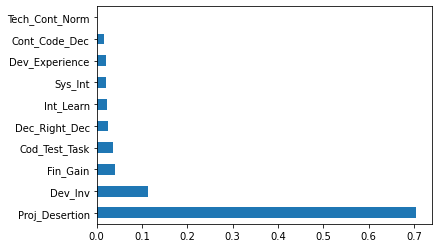

In [28]:
# Adaboost 
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

# Choosing Decision Tree with 1 level as the weak learner
# Choose different values of max_depth, n_estimators and learning_rate to tune the model
DTC=DecisionTreeClassifier(max_depth=4)
clf = AdaBoostClassifier(n_estimators=200, base_estimator=DTC ,learning_rate=0.01)

# Printing all the parameters of Adaboost
print(clf)

# Creating the model on Training Data
AB=clf.fit(X_train,y_train)
prediction_AB=AB.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_AB))
print(metrics.confusion_matrix(y_test, prediction_AB))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_AB, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(AB, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

# Plotting the feature importance for Top 10 most important columns
%matplotlib inline
feature_importances = pd.Series(AB.feature_importances_, index=Predictors)
feature_importances.nlargest(10).plot(kind='barh')

In [29]:
from sklearn.metrics import roc_curve, auc
roc_curve(y_test, prediction_AB)

(array([0.        , 0.06666667, 1.        ]),
 array([0., 1., 1.]),
 array([2, 1, 0]))

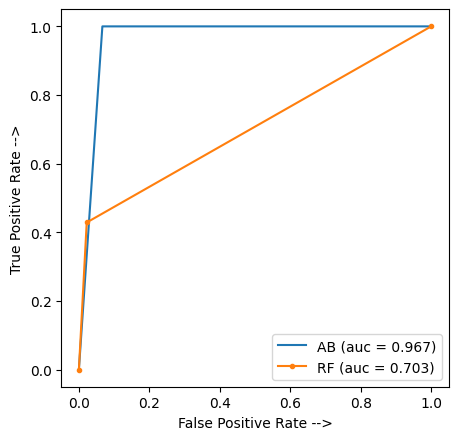

In [70]:
from sklearn.metrics import roc_curve, auc

AB_fpr, AB_tpr, threshold = roc_curve(y_test, prediction_AB)
auc_AB = auc(AB_fpr,AB_tpr)

randomForest_fpr, randomForest_tpr, threshold = roc_curve(y_test, prediction_RF)
auc_randomForest = auc(randomForest_fpr, randomForest_tpr)

plt.figure(figsize=(5, 5), dpi=100)
plt.plot(AB_fpr, AB_tpr, linestyle='-', label='AB (auc = %0.3f)' % auc_AB)
plt.plot(logistic_fpr, logistic_tpr, marker='.', label='RF (auc = %0.3f)' % auc_logistic)

plt.xlabel('False Positive Rate -->')
plt.ylabel('True Positive Rate -->')

plt.legend()

plt.show()

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, gamma=None,
              gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=10,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, predictor=None, random_state=None,
              reg_alpha=None, reg_lambda=None, ...)
              precision    recall  f1-score   support

           0       0.96      0.96      0.96        45
           1       0.71      0.71      0.71         7

    accuracy                           0.92        52
   macro avg       0.83      0.83      

<AxesSubplot:>

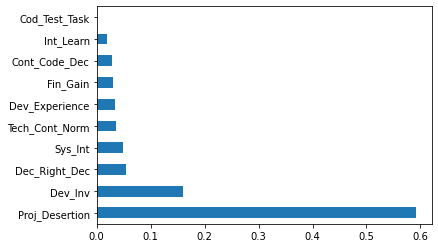

In [31]:
# Xtreme Gradient Boosting (XGBoost)
from xgboost import XGBClassifier
clf=XGBClassifier(max_depth=10, learning_rate=0.01, n_estimators=200, objective='binary:logistic', booster='gbtree')

# Printing all the parameters of XGBoost
print(clf)

# Creating the model on Training Data
XGB=clf.fit(X_train,y_train)
prediction_XGB=XGB.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_XGB))
print(metrics.confusion_matrix(y_test, prediction_XGB))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_XGB, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(XGB, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

# Plotting the feature importance for Top 10 most important columns
%matplotlib inline
feature_importances = pd.Series(XGB.feature_importances_, index=Predictors)
feature_importances.nlargest(10).plot(kind='barh')

In [32]:
## Hyper Parameter Optimization

params={
 "learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
 "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
 "min_child_weight" : [ 1, 3, 5, 7 ],
 "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
 "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
    
}
## Hyperparameter optimization using RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import xgboost


clf=xgboost.XGBClassifier()
random_search=RandomizedSearchCV(clf,param_distributions=params,n_iter=5,scoring='roc_auc',n_jobs=-1,cv=5,verbose=3)

random_search.fit(X,y)


Fitting 5 folds for each of 5 candidates, totalling 25 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, gamma=None,
                                           gpu_id=None, grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate=None, max_bin=None,...
                                           n_estimators=100, n_jobs=None,
                                           num_parallel_tree=None,
                                           predictor=None, random_state=None,
                                           reg_alpha=None, reg_lambda=None, ...),
                   n_iter=5, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.3, 0.4, 0.5,
                                                             0.7],
                                        'gamma': [0.0, 0.1, 0.2, 0.3, 0.4],
                                        'learning_rate': [0.05, 0.1, 0.15, 0.2,
                                                          0.25, 0.3],
                                        'max_depth': [3, 4, 5, 6, 8, 10, 12,
                                                      15],
                                        'min_child_weight': [1, 3, 5, 7]},
                   scoring='roc_auc', verbose=3)

In [33]:
random_search.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.7,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0.0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.15, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=12, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)

In [34]:
random_search.best_params_

{'min_child_weight': 1,
 'max_depth': 12,
 'learning_rate': 0.15,
 'gamma': 0.0,
 'colsample_bytree': 0.7}

In [35]:
classifier=xgboost.XGBClassifier(base_score=0.5, colsample_bytree=0.7, gamma=0.3, learning_rate=0.1, max_depth=10, min_child_weight=5, booster='gbtree',max_delta_step=0,n_estimators=200, n_jobs=1, nthread=None,
       objective='binary:logistic', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1)

In [36]:
from sklearn.model_selection import cross_val_score
score=cross_val_score(classifier,X,y,cv=10)

[07:09:31] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[07:09:33] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[07:09:34] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting fl

In [37]:
score

array([0.94444444, 0.88888889, 0.94444444, 0.94117647, 0.88235294,
       0.88235294, 0.82352941, 1.        , 0.94117647, 1.        ])

In [38]:
score.mean()

0.9248366013071895

In [39]:
XGB=classifier.fit(X_train,y_train)
prediction_XGB=XGB.predict(X_test)

[07:10:19] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




In [ ]:
# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_XGB))
print(metrics.confusion_matrix(y_test, prediction_XGB))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_XGB, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(XGB, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

# Plotting the feature importance for Top 4 most important columns
%matplotlib inline
feature_importances = pd.Series(XGB.feature_importances_, index=Predictors)
feature_importances.nlargest(4).plot(kind='barh')

              precision    recall  f1-score   support

           0       0.93      0.96      0.95        45
           1       0.67      0.57      0.62         7

    accuracy                           0.90        52
   macro avg       0.80      0.76      0.78        52
weighted avg       0.90      0.90      0.90        52

[[43  2]
 [ 3  4]]
Accuracy of the model on Testing Sample Data: 0.9
[08:41:29] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[08:41:31] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some paramet

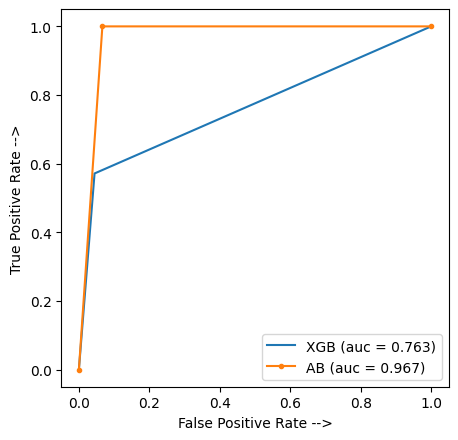

In [71]:
from sklearn.metrics import roc_curve, auc

XGB_fpr, XGB_tpr, threshold = roc_curve(y_test, prediction_XGB)
auc_XGB = auc(XGB_fpr,XGB_tpr)

AB_fpr, AB_tpr, threshold = roc_curve(y_test, prediction_AB)
auc_AB = auc(AB_fpr, AB_tpr)

plt.figure(figsize=(5, 5), dpi=100)
plt.plot(XGB_fpr, XGB_tpr, linestyle='-', label='XGB (auc = %0.3f)' % auc_XGB)
plt.plot(AB_fpr, AB_tpr, marker='.', label='AB (auc = %0.3f)' % auc_AB)

plt.xlabel('False Positive Rate -->')
plt.ylabel('True Positive Rate -->')

plt.legend()

plt.show()

In [72]:
X_train.shape
X_test.shape

(52, 10)

In [75]:
# Naive Bays
from sklearn.naive_bayes import GaussianNB, MultinomialNB

# GaussianNB is used in Binomial Classification
# MultinomialNB is used in multi-class classification
clfNaive = GaussianNB()
#clf = MultinomialNB()

# Printing all the parameters of Naive Bayes
print(clfNaive)

NB=clfNaive.fit(X_train,y_train)
prediction_NB=NB.predict(X_test)

# Measuring accuracy on Testing Data
from sklearn import metrics
print(metrics.classification_report(y_test, prediction_NB))
print(metrics.confusion_matrix(y_test, prediction_NB))

# Printing the Overall Accuracy of the model
F1_Score=metrics.f1_score(y_test, prediction_NB, average='weighted')
print('Accuracy of the model on Testing Sample Data:', round(F1_Score,2))

# Importing cross validation function from sklearn
from sklearn.model_selection import cross_val_score

# Running 10-Fold Cross validation on a given algorithm
# Passing full data X and y because the K-fold will split the data and automatically choose train/test
Accuracy_Values=cross_val_score(NB, X , y, cv=10, scoring='f1_weighted')
print('\nAccuracy values for 10-fold Cross Validation:\n',Accuracy_Values)
print('\nFinal Average Accuracy of the model:', round(Accuracy_Values.mean(),2))

GaussianNB()
              precision    recall  f1-score   support

           0       0.93      0.91      0.92        45
           1       0.50      0.57      0.53         7

    accuracy                           0.87        52
   macro avg       0.72      0.74      0.73        52
weighted avg       0.87      0.87      0.87        52

[[41  4]
 [ 3  4]]
Accuracy of the model on Testing Sample Data: 0.87

Accuracy values for 10-fold Cross Validation:
 [0.93978495 0.94745484 0.89880952 1.         0.88235294 0.76470588
 0.94428883 0.83286648 0.94428883 1.        ]

Final Average Accuracy of the model: 0.92


In [76]:
# Getting the test data
test=pd.read_csv("test.csv")

In [77]:
test.head()

,Dev_ID,Geographic_Regions,Int_Learn,Fin_Gain,Expt_Het,Tech_Cont_Norm,Sys_Int,Cod_Test_Task,Cont_Code_Dec,Dec_Right_Dec,Dev_Inv,Proj_Desertion,Project_Age,Dev_Status,Gender,Age,Education,Dev_Experience
0,1001,Asia,6.00,5.00,2.00,4.67,5.50,4.8,3.8,4.2,4.0,7.0,<1 year,Planning,M,30–39,Doctorate,1
1,1002,North America,5.67,4.75,2.33,4.50,4.75,4.6,4.0,3.6,6.2,2.4,2-3 years,Alpha,F,40–49,Doctorate,5
2,1003,Caribbean,6.67,6.50,1.00,4.83,6.00,6.2,5.4,3.6,6.8,4.0,<1 year,Pre-alpha,F,30–39,Masters,1
3,1004,Central America,5.67,5.75,1.33,5.33,6.50,3.8,1.8,2.2,7.0,1.4,<1 year,Planning,M,30–39,Masters,1
4,1005,Europe,5.00,5.50,2.33,4.67,5.00,4.2,3.2,4.2,4.4,3.8,1-2 years,Pre-alpha,M,30–39,Doctorate,2


In [78]:
#Droping unnecessary columns
testData=test.drop(columns=['Dev_ID','Geographic_Regions','Gender','Age','Project_Age','Dev_Status','Education','Expt_Het'],axis=1)

In [79]:
testData.head()

,Int_Learn,Fin_Gain,Tech_Cont_Norm,Sys_Int,Cod_Test_Task,Cont_Code_Dec,Dec_Right_Dec,Dev_Inv,Proj_Desertion,Dev_Experience
0,6.00,5.00,4.67,5.50,4.8,3.8,4.2,4.0,7.0,1
1,5.67,4.75,4.50,4.75,4.6,4.0,3.6,6.2,2.4,5
2,6.67,6.50,4.83,6.00,6.2,5.4,3.6,6.8,4.0,1
3,5.67,5.75,5.33,6.50,3.8,1.8,2.2,7.0,1.4,1
4,5.00,5.50,4.67,5.00,4.2,3.2,4.2,4.4,3.8,2


In [80]:
#Keeping Copy of datset for future reference
mainTestData=testData.copy()
#Calculation Missing VAlues in indivisual column
testData.isnull().sum()

Int_Learn         0
Fin_Gain          0
Tech_Cont_Norm    0
Sys_Int           0
Cod_Test_Task     0
Cont_Code_Dec     0
Dec_Right_Dec     0
Dev_Inv           0
Proj_Desertion    0
Dev_Experience    0
dtype: int64

In [81]:
# Deployment of the Model

In [82]:
# Step 1. Retraining the model using 100% data
# XGBoost 
import xgboost
from sklearn.tree import DecisionTreeClassifier

# Using the XGBoost algorithm with final hyperparamters
classifier=xgboost.XGBClassifier(base_score=0.5, colsample_bytree=0.7, gamma=0.3, learning_rate=0.1, max_depth=10, min_child_weight=5, booster='gbtree',max_delta_step=0,n_estimators=200, n_jobs=1, nthread=None,
       objective='binary:logistic', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1)

# Training the model on 100% Data available
FinalXGBModel=classifier.fit(X,y)

[08:30:12] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




In [83]:
# Step 2. Save the model as a serialized file which can be stored anywhere
import pickle
import os

# Saving the Python objects as serialized files can be done using pickle library
# Here let us save the Final ZomatoRatingModel
with open('FinalXGBModel.pkl', 'wb') as fileWriteStream:
    pickle.dump(FinalXGBModel, fileWriteStream)
    # Don't forget to close the filestream!
    fileWriteStream.close()
    
print('pickle file of Predictive Model is saved at Location:',os.getcwd())

pickle file of Predictive Model is saved at Location: /home/abdullyahuza/shehuDir/committer-promotion/DA_And_ModelBuilding


In [84]:
# This Function can be called from any from any front end tool/website
def predict_promotion(test):
    DataSet=test
    #Avoidng Dumy Trap for applying Drop First
    DataSet=pd.get_dummies(DataSet,drop_first=True)
    # Maintaining the same order of columns as it was during the model training
    Num_Inputs = DataSet.shape[0]
    print(Num_Inputs)
    Predictors=['Int_Learn','Fin_Gain','Tech_Cont_Norm','Sys_Int','Cod_Test_Task','Cont_Code_Dec', 'Dec_Right_Dec','Dev_Inv', 'Proj_Desertion','Dev_Experience']
    X=DataSet[Predictors].values
    X=PredictorScalerFit.transform(X)
    print(X)
    # Loading the Function from pickle file
    import pickle
    with open('FinalXGBModel.pkl', 'rb') as fileReadStream:
        XGB_model=pickle.load(fileReadStream)
        # Don't forget to close the filestream!
        fileReadStream.close()
        
    # Genrating Predictions
    Prediction=XGB_model.predict(X)
    PredictedStatus=pd.DataFrame(Prediction, columns=['Predicted Status'])
    
    return(PredictedStatus)

In [85]:
predict_promotion(test)

173
[[0.83333333 0.66666667 0.84757506 ... 0.5        1.         0.        ]
 [0.77833333 0.625      0.80831409 ... 0.86666667 0.23333333 0.8       ]
 [0.945      0.91666667 0.88452656 ... 0.96666667 0.5        0.        ]
 ...
 [0.77833333 0.66666667 0.92378753 ... 0.73333333 0.43333333 0.        ]
 [0.72166667 0.5        0.84757506 ... 0.66666667 0.83333333 0.2       ]
 [0.5        0.625      0.80831409 ... 0.43333333 0.83333333 0.        ]]


,Predicted Status
0,0
1,1
2,0
3,1
4,0
...,...
168,0
169,0
170,0
171,0
